In [1]:
%matplotlib inline # 配置
# 导包
import pandas as pd # 一种分析结构化数据集的工具
import numpy as np  # 数学运算函数库
from matplotlib import pyplot as plt # 画图库
plt.style.use('ggplot')   # 给画图库初始化

import seaborn as sns # 可视化库
color = sns.color_palette() # 获取调色盘
sns.set(rc={'figure.figsize': (25, 15)}) #初始化 可视化库

import plotly # 可视化框架
plotly.offline.init_notebook_mode(connected=True) # 离线可视化,让图表可以嵌入到notebook中
import plotly.graph_objs as go # 图形对象集合

import warnings # 压制警告
warnings.filterwarnings('ignore')

## Read filer, Get data

In [2]:
df = pd.read_csv('googleplaystore.csv') # 获取googleplaystore.csv的流
# 处理特殊情况
df.drop_duplicates(subset='App', inplace=True) # 去重
df = df[df['Android Ver'] != np.nan] #去空
df = df[df['Android Ver'] != 'NaN']  
df = df[df['Installs'] != 'Free']    
df = df[df['Installs'] != 'Paid']


In [3]:
print('Number of apps in the dataset : ' , len(df))
df.sample(7) # 简单输出

Number of apps in the dataset :  9659


,App,Category,Rating,Reviews,Size,Installs,Type,Price,Content Rating,Genres,Last Updated,Current Ver,Android Ver
7658,SharedCare™ Co-parenting,PARENTING,2.0,23,Varies with device,100+,Paid,$4.59,Everyone,Parenting,"June 19, 2016",3.0.3,4.0 and up
9626,Learn Body Parts in English,FAMILY,4.0,7243,42M,"1,000,000+",Free,0,Everyone,Education,"December 6, 2016",5.13,2.3 and up
9640,"Univision Deportes: Liga MX, MLS, Fútbol En Vivo",SPORTS,4.2,75566,Varies with device,"5,000,000+",Free,0,Everyone,Sports,"July 23, 2018",Varies with device,Varies with device
8212,Scale Models DB,TOOLS,4.4,9,33M,50+,Paid,$2.99,Everyone,Tools,"May 3, 2018",0.6.2,4.3 and up
7687,CP Plus Showcase,BUSINESS,4.3,236,7.0M,"50,000+",Free,0,Everyone,Business,"March 9, 2018",1.0.4,4.0 and up
1437,7 Cups: Anxiety & Stress Chat,HEALTH_AND_FITNESS,4.2,13799,Varies with device,"500,000+",Free,0,Teen,Health & Fitness,"July 31, 2018",Varies with device,Varies with device
8423,Bike Unchained,SPORTS,4.3,83545,23M,"5,000,000+",Free,0,Everyone,Sports,"July 31, 2018",1.193,4.0 and up


## 符号处理

In [4]:
# - Installs : Remove + and ,
df['Installs'] = df['Installs'].apply(lambda x : x.replace('+', '') if '+' in x else x)
df['Installs'] = df['Installs'].apply(lambda x : x.replace(',', '') if ',' in x else x)
df['Installs'] = df['Installs'].apply(lambda x : int(x))
# df.head()

In [5]:
# - Size : Remove 'M', Replace 'k' and divide by 10^-3
#df['Size'] = df['Size'].fillna(0)
df['Size'] = df['Size'].apply(lambda x : x.replace('Varies with device', 'NaN') if 'Varies with device' in str(x) else x)
df['Size'] = df['Size'].apply(lambda x : x.replace('M', '') if 'M' in x else x)
df['Size'] = df['Size'].apply(lambda x : float(x.replace('k', '')) / 1000 if 'k' in x else x)
df['Size'] = df['Size'].apply(lambda x : float(x))
df['Installs'] = df['Installs'].apply(lambda x : float(x))
df['Price'] = df['Price'].apply(lambda x : x.replace('$', '') if '$' in x else x).astype(float)
df['Reviews'] = df['Reviews'].astype(int)
# df.head()

## 成对关系

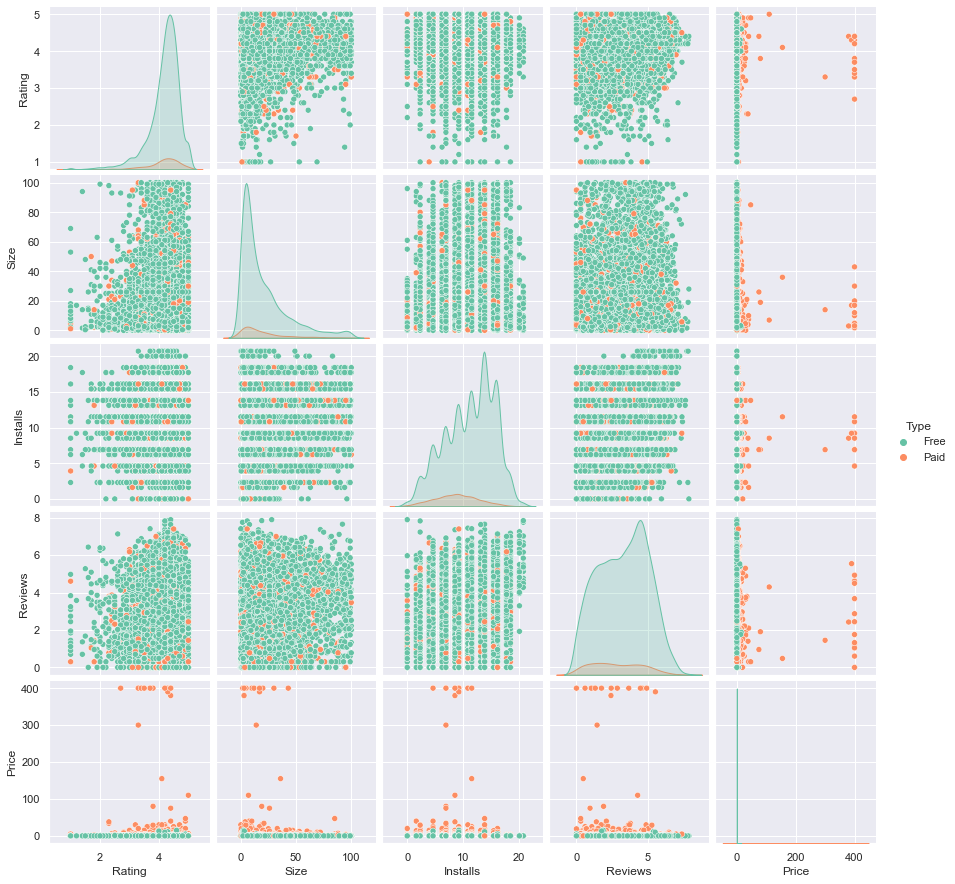

In [6]:
x = df['Rating'].dropna()
y = df['Size'].dropna()
z = df['Installs'][df.Installs != 0].dropna()
p = df['Reviews'][df.Reviews != 0].dropna()
t = df['Type'].dropna()
price = df['Price']

p = sns.pairplot(pd.DataFrame(list(zip(x, y, np.log(z), np.log10(p), t, price)), columns=['Rating', 'Size', 'Installs', 'Reviews', 'Type', 'Price']), hue='Type', palette='Set2')

## Pie图，分析占比

In [7]:
number_of_apps = df['Category'].value_counts().sort_values(ascending=True)

data = [go.Pie(
    labels=number_of_apps.index,
    values=number_of_apps.values,
    hoverinfo='label+value'
)]
plotly.offline.iplot(data, filename='active_category')

## 直方图，分析评分分布

In [8]:
data = [go.Histogram(
    x = df.Rating,
    xbins={'start': 1, 'size': 0.1, 'end': 5}
)]
print('Average app rating = ', np.mean(df.Rating))
plotly.offline.iplot(data, filename='overall_rating_distribution')

Average app rating =  4.173243045387994


## 各分类的单因素方差分析

F_onewayResult(statistic=12.79263715618054, pvalue=2.323280446259348e-20)

The p-value is extremely small, hence we reject the null hypothesis in favor of the alternate hypothesis.



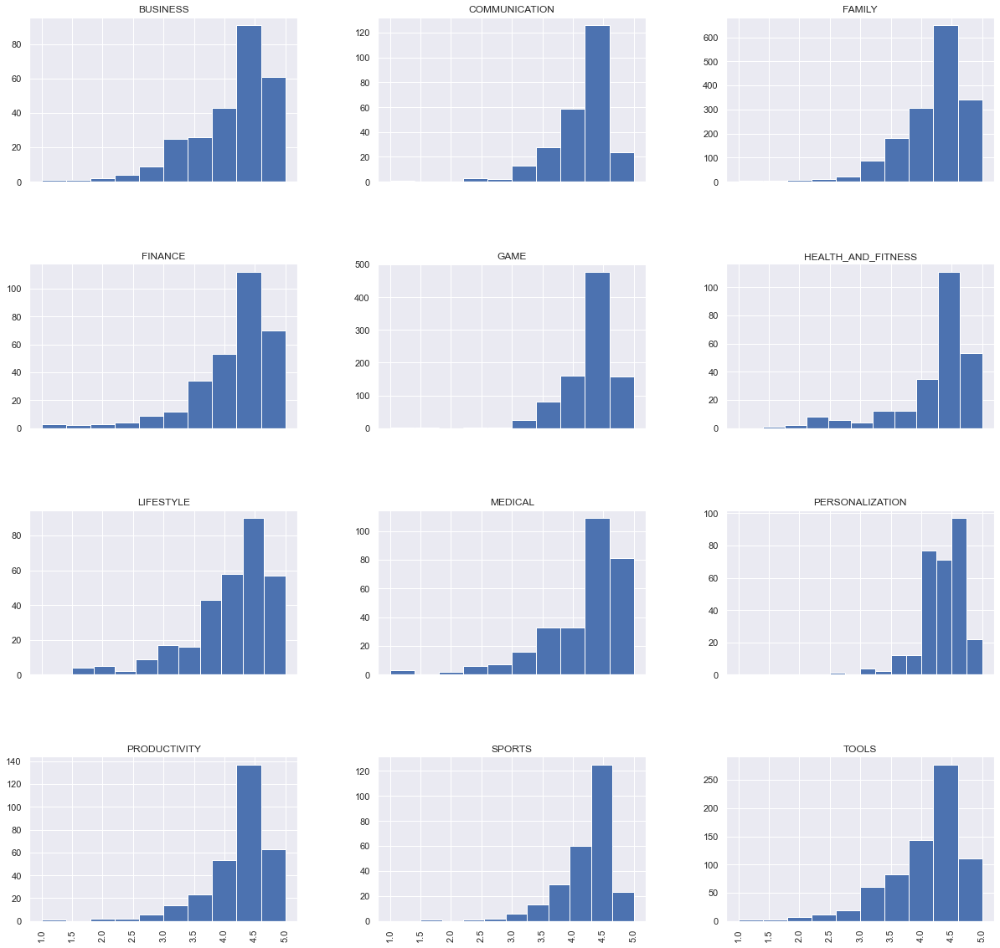

In [9]:
import scipy.stats as stats 
f = stats.f_oneway(df.loc[df.Category == 'BUSINESS']['Rating'].dropna(), 
               df.loc[df.Category == 'FAMILY']['Rating'].dropna(),
               df.loc[df.Category == 'GAME']['Rating'].dropna(),
               df.loc[df.Category == 'PERSONALIZATION']['Rating'].dropna(),
               df.loc[df.Category == 'LIFESTYLE']['Rating'].dropna(),
               df.loc[df.Category == 'FINANCE']['Rating'].dropna(),
               df.loc[df.Category == 'EDUCATION']['Rating'].dropna(),
               df.loc[df.Category == 'MEDICAL']['Rating'].dropna(),
               df.loc[df.Category == 'TOOLS']['Rating'].dropna(),
               df.loc[df.Category == 'PRODUCTIVITY']['Rating'].dropna()
              )
print(f)
print('\nThe p-value is extremely small, hence we reject the null hypothesis in favor of the alternate hypothesis.\n')

groups = df.groupby('Category').filter(lambda x : len(x) > 286).reset_index()
array = groups['Rating'].hist(by=groups['Category'], sharex=True, figsize=(20, 20))

## 最佳表现类别

In [10]:
groups = df.groupby('Category').filter(lambda x : len(x) >= 170).reset_index()
print('Average rating = ', np.mean(list(groups.Rating)))
c = ['hsl('+str(h)+',50%'+',50%' for h in np.linspace(0, 720, len(set(groups.Category)))]

layout = {'title' : 'App ratings across major categories',
        'xaxis': {'tickangle':-40},
        'yaxis': {'title': 'Rating'},
          'plot_bgcolor': 'rgb(250,250,250)',
          'shapes': [{
              'type' :'line',
              'x0': -.5,
              'y0': np.nanmean(list(groups.Rating)),
              'x1': 19,
              'y1': np.nanmean(list(groups.Rating)),
              'line': { 'dash': 'dashdot'}
          }]
          }
data = [{
    'y': df.loc[df.Category==category]['Rating'], 
    'type':'violin',
    'name' : category,
    'showlegend':False,
    #'marker': {'color': 'Set2'},
    } for i,category in enumerate(list(set(groups.Category)))]
plotly.offline.iplot({'data': data, 'layout': layout})

Average rating =  nan


## 分析安装包大小（50MB区分）和评分

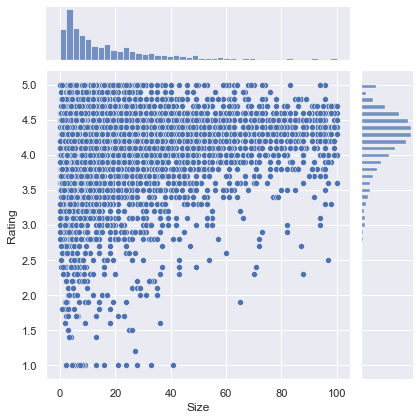

In [11]:
groups = df.groupby('Category').filter(lambda x: len(x) >= 50).reset_index()

sns.set_style("darkgrid")
ax = sns.jointplot(df['Size'], df['Rating'])


## GAME & FAMILY 的大小，评分分布统计

In [12]:
c = ['hsl('+str(h)+',50%'+',50%)' for h in np.linspace(0, 360, len(list(set(groups.Category))))]

subset_df = df[df.Size > 40]
groups_temp = subset_df.groupby('Category').filter(lambda x : len(x) > 20)

data = [{
    'x': groups_temp.loc[subset_df.Category==category[1]]['Rating'], 
    'type':'scatter',
    'y' : subset_df['Size'],
    'name' : str(category[1]),
    'mode' : 'markers',
    'showlegend': True,
    #'marker': {'color':c[i]}
    #'text' : df['rating'],
    } for category in enumerate(['GAME', 'FAMILY'])]
layout = {'title':"Rating vs Size", 
          'xaxis': {'title' : 'Rating'},
          'yaxis' : {'title' : 'Size (in MB)'},
         'plot_bgcolor': 'rgb(0,0,0)'}

plotly.offline.iplot({'data': data, 'layout': layout})

## 商店的价格策略

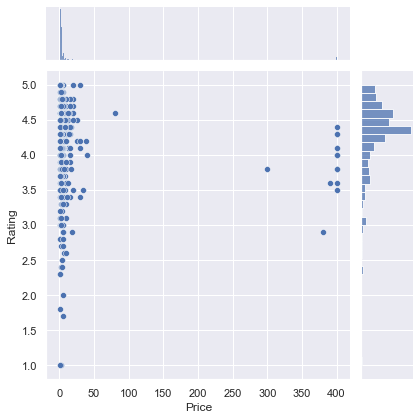

In [13]:
paid_apps = df[df.Price > 0]
p = sns.jointplot("Price", "Rating", paid_apps)

## 价格分类统计

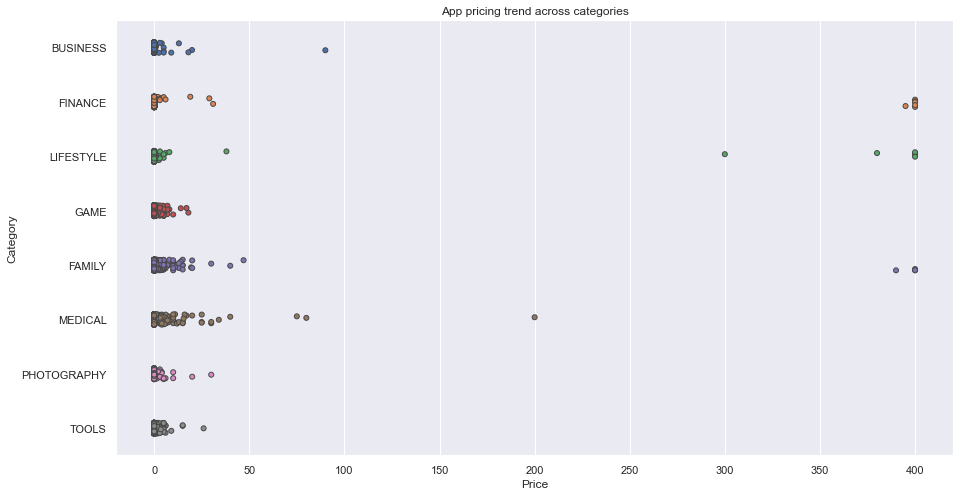

In [14]:
subset_df = df[df.Category.isin(['GAME', 'FAMILY', 'PHOTOGRAPHY', 'MEDICAL', 'TOOLS', 'FINANCE','LIFESTYLE','BUSINESS'])]
sns.set_style('darkgrid')
fig, ax = plt.subplots()
fig.set_size_inches(15, 8)
p = sns.stripplot(x="Price", y="Category", data=subset_df, jitter=True, linewidth=1)
title = ax.set_title('App pricing trend across categories')

## 高价应用

In [15]:
df[['Category', 'App']][df.Price > 200]

,Category,App
4197,FAMILY,most expensive app (H)
4362,LIFESTYLE,💎 I'm rich
4367,LIFESTYLE,I'm Rich - Trump Edition
5351,LIFESTYLE,I am rich
5354,FAMILY,I am Rich Plus
5355,LIFESTYLE,I am rich VIP
5356,FINANCE,I Am Rich Premium
5357,LIFESTYLE,I am extremely Rich
5358,FINANCE,I am Rich!
5359,FINANCE,I am rich(premium)


## 去除少量的高价格应用

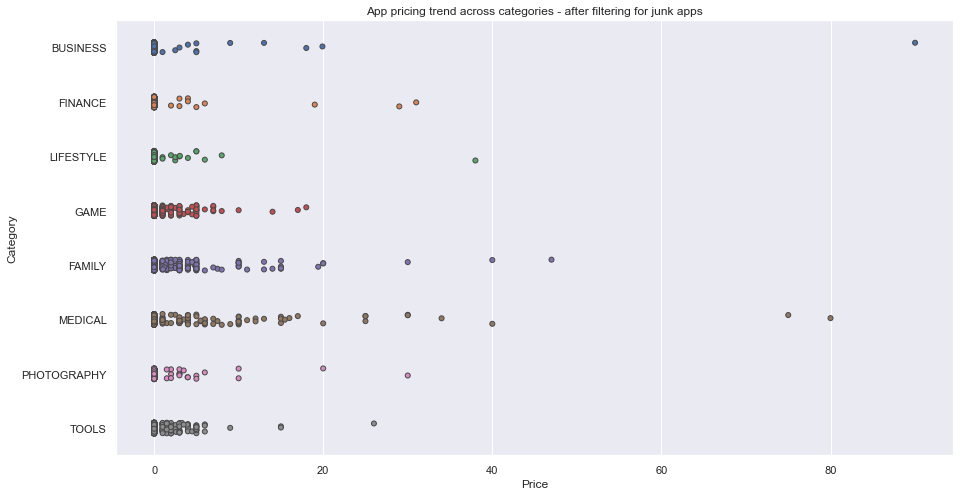

In [16]:
fig, ax = plt.subplots()
fig.set_size_inches(15, 8)
subset_df_price = subset_df[subset_df.Price < 100]
p = sns.stripplot(x="Price", y="Category", data=subset_df_price, jitter=True, linewidth=1)
title = ax.set_title("App pricing trend across categories - after filtering for junk apps")

## Pie中，分类统计Free和Paid占比

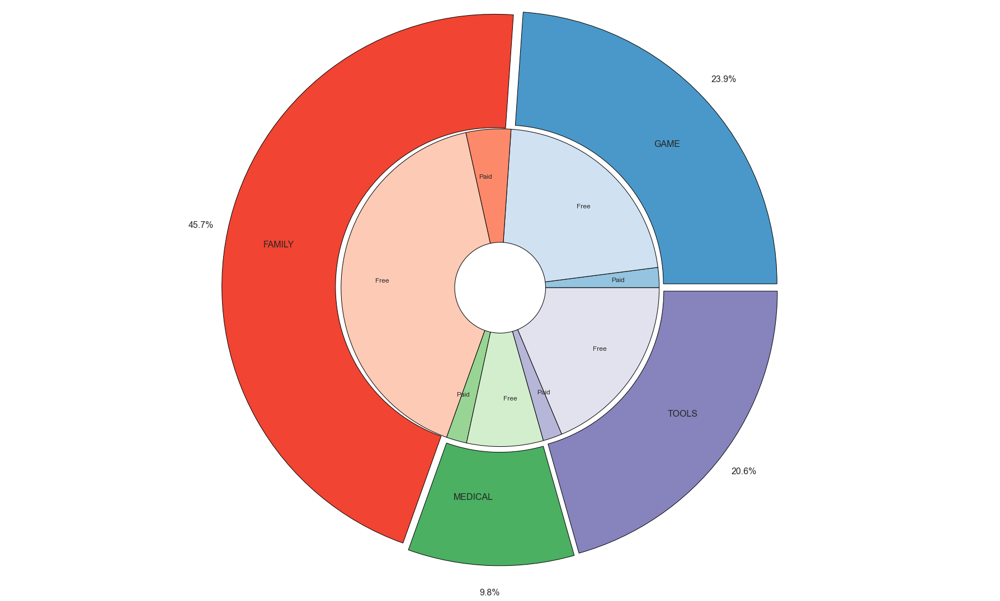

In [17]:
new_df = df.groupby(['Category', 'Type']).agg({'App': 'count'}).reset_index()

outer_group_names = ['GAME', 'FAMILY', 'MEDICAL', 'TOOLS']
outer_group_values = [len(df.App[df.Category == category]) for category in outer_group_names]
a, b, c, d = [plt.cm.Blues, plt.cm.Reds, plt.cm.Greens, plt.cm.Purples]

inner_group_names = ['Paid', 'Free'] * 4
inner_group_values = []

for category in outer_group_names:
    for t in ['Paid', 'Free']:
        x = new_df[new_df.Category == category]
        try:
            inner_group_values.append(int(x.App[x.Type == t].values[0]))
        except:
            inner_group_values.append(0)
explode = (0.025, 0.025, 0.025, 0.025)
fig, ax = plt.subplots()
ax.axis('equal')
mypie, texts, _ = ax.pie(outer_group_values, radius=1.2, labels=outer_group_names, autopct='%1.1f%%', pctdistance=1.1, labeldistance=0.75, explode=explode, colors=[a(0.6), b(0.6), c(0.6), d(0.6)], textprops={'fontsize': 16})
plt.setp(mypie, width=0.5, edgecolor='black')

# Second Ring (Inside)
mypie2, _ = ax.pie(inner_group_values, radius=1.2-0.5, labels=inner_group_names, labeldistance= 0.7, textprops={'fontsize': 12}, colors = [a(0.4), a(0.2), b(0.4), b(0.2), c(0.4), c(0.2), d(0.4), d(0.2)])
plt.setp( mypie2, width=0.5, edgecolor='black')
plt.margins(0,0)
 
# show it
plt.tight_layout()
plt.show()


## 分析付费下载应用数量对比免费应用

In [18]:
trace0 = go.Box(
    y = np.log10(df['Installs'][df.Type == 'Paid']),
    name = 'Paid',
    marker= dict(
        color = 'rgb(214, 12, 140)'
    )
)
trace1 = go.Box(
    y = np.log10(df['Installs'][df.Type == 'Free']),
    name = 'Free',
    marker= dict(
        color = 'rgb(0, 128, 128)'
    )
)
layout = go.Layout(
    title = 'Number of downloads of paid apps Vs free apps',
    yaxis= {'title': 'Number of downloads (log-scaled)'}
)
data = [trace0, trace1]
plotly.offline.iplot({'data': data, 'layout': layout})

## 评分与安装包大小的统计

In [19]:
temp_df = df[df.Type == 'Paid']
temp_df = temp_df[temp_df.Size > 5]

data = [{
    'x': temp_df['Rating'],
    'type': 'scatter',
    'name': t,
    'y': temp_df['Size'],
    'mode': 'markers',
    'text': df['Size']
} for t in set(temp_df.Type)]
layout = {'title': "Rating vs Size",
'xaxis': {'title': 'Rating'},
'yaxis': {'title': 'Size (in MB)'},
'plot_bgcolor': 'rgb(0, 0, 0)'}
plotly.offline.iplot(data, layout)

## 统计相关性

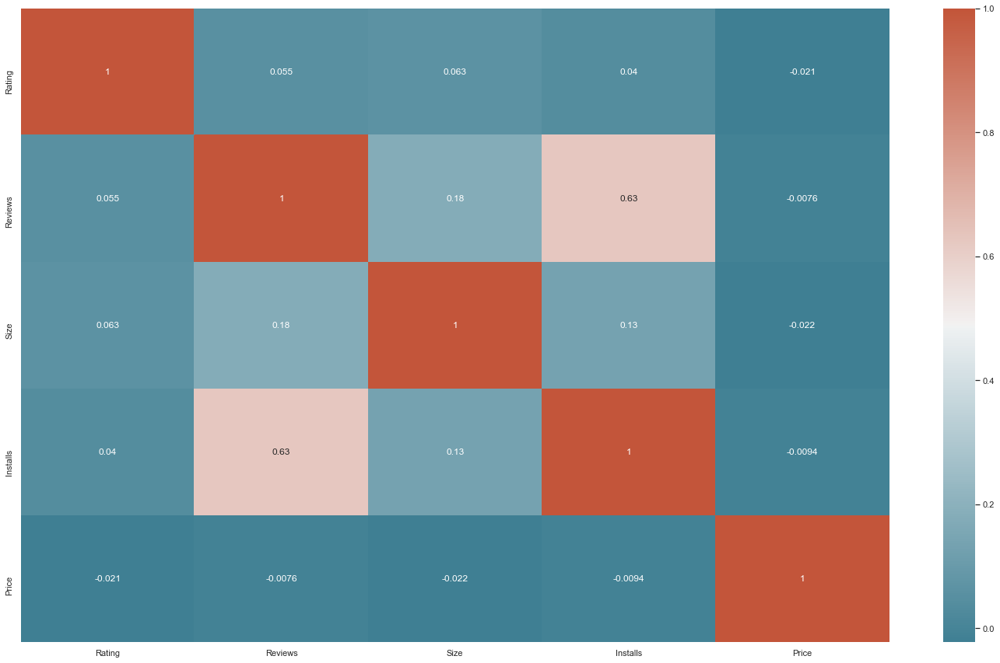

In [20]:
corrmat = df.corr()
p = sns.heatmap(corrmat, annot=True, cmap=sns.diverging_palette(220, 20, as_cmap=True))

## 统计下载量与评论量的关系

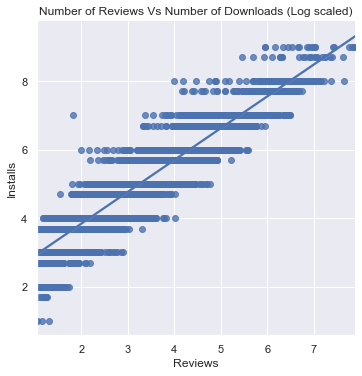

In [21]:
df_copy = df.copy()

df_copy = df_copy[df_copy.Reviews > 10]
df_copy = df_copy[df_copy.Installs > 0]

df_copy['Installs'] = np.log10(df['Installs'])
df_copy['Reviews'] = np.log10(df['Reviews'])

sns.lmplot('Reviews', 'Installs', data=df_copy)
ax = plt.gca()
_ = ax.set_title('Number of Reviews Vs Number of Downloads (Log scaled)')

## 用户评论的情绪分析（积极的，中性的，消极的）

In [22]:
revires_df = pd.read_csv('googleplaystore_user_reviews.csv')


In [23]:
merges_df = pd.merge(df, revires_df, on = "App", how="inner")
merges_df = merges_df.dropna(subset=['Sentiment', 'Translated_Review'])


In [24]:
grouped_sentiment_category_count = merges_df.groupby(['Category', 'Sentiment']).agg({"App": "count"}).reset_index()
grouped_sentiment_category_sum = merges_df.groupby(['Category']).agg({"Sentiment": 'count'}).reset_index()

new_df = pd.merge(grouped_sentiment_category_count, grouped_sentiment_category_sum, on='Category')
new_df['Sentiment_Normalized'] = new_df.App / new_df.Sentiment_y 
new_df = new_df.groupby('Category').filter(lambda x: len(x) == 3)

trace1 = go.Bar(
    x=list(new_df.Category[::3])[6:-5],
    y= new_df.Sentiment_Normalized[::3][6:-5],
    name='Negative',
    marker=dict(color = 'rgb(209,49,20)')
)

trace2 = go.Bar(
    x=list(new_df.Category[::3])[6:-5],
    y= new_df.Sentiment_Normalized[1::3][6:-5],
    name='Neutral',
    marker=dict(color = 'rgb(49,130,189)')
)

trace3 = go.Bar(
    x=list(new_df.Category[::3])[6:-5],
    y= new_df.Sentiment_Normalized[2::3][6:-5],
    name='Positive',
    marker=dict(color = 'rgb(49,189,120)')
)

data = [trace1, trace2, trace3]
layout = go.Layout(
    title = 'Sentiment analysis',
    barmode='stack',
    xaxis = {'tickangle': -45},
    yaxis = {'title': 'Fraction of reviews'}
)

fig = go.Figure(data=data, layout=layout)
plotly.offline.iplot({'data': data, 'layout': layout})

## 付费应用与免费应用的情绪分布

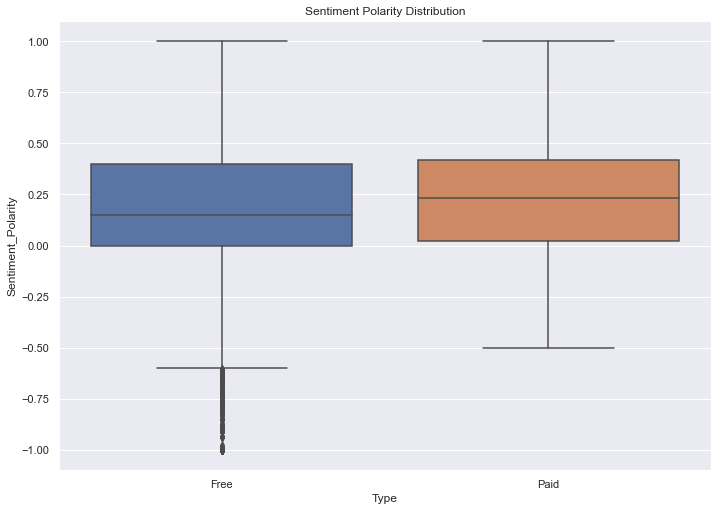

In [25]:
sns.set_style('ticks')
sns.set_style('darkgrid')
fig, ax = plt.subplots()
fig.set_size_inches(11.7, 8.27)
ax = sns.boxplot(x='Type', y='Sentiment_Polarity', data=merges_df)
title = ax.set_title("Sentiment Polarity Distribution")

## 用户评论的高频词语统计

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\damit\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


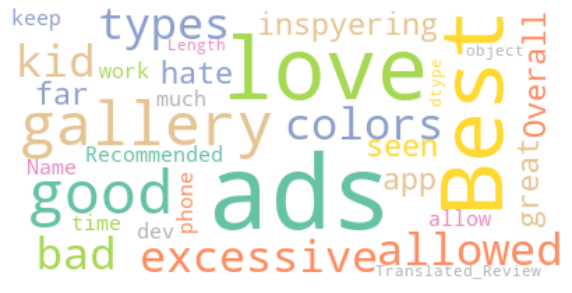

In [26]:
from wordcloud import WordCloud
wc = WordCloud(background_color='white', max_words=200, colormap='Set2')

import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
stop = stopwords.words('english')
stop = stop + ['app', 'APP' ,'ap', 'App', 'apps', 'application', 'browser', 'website', 'websites', 'chrome', 'click', 'web', 'ip', 'address',
            'files', 'android', 'browse', 'service', 'use', 'one', 'download', 'email', 'Launcher']

merges_df['Translated_Review'] = merges_df['Translated_Review'].apply(lambda x: " ".join(x for x in str(x).split(' ') if x not in stop))
merges_df.Translated_Review = merges_df.Translated_Review.apply(lambda x: x if 'app' not in x.split(' ') else np.nan)
merges_df.dropna(subset=['Translated_Review'], inplace=True)

free = merges_df.loc[merges_df.Type == 'Free']['Translated_Review'].apply(lambda x: x if x == 'nan' else x)
wc.generate(''.join(str(free)))
plt.figure(figsize=(10, 10))
plt.imshow(wc, interpolation='bilinear')
plt.axis('off')
plt.show()

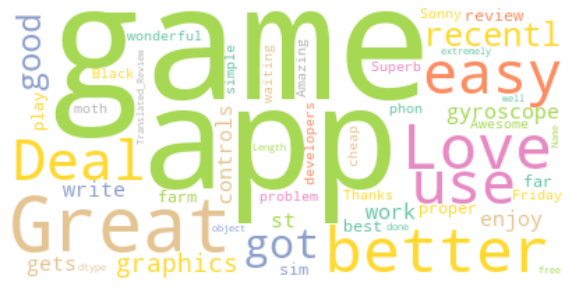

In [27]:
paid = merges_df.loc[merges_df.Type == 'Paid']['Translated_Review'].apply(lambda x: '' if x == 'nan' else x)
wc.generate(''.join(str(paid)))
plt.figure(figsize=(10, 10))
plt.imshow(wc, interpolation='bilinear')
plt.axis('off')
plt.show()